## Data Description

You can get data from WHO : https://data.who.int/dashboards/covid19/data

| Field name | Type | Description |
| --- | --- | --- |
| Date_reported | Date | Date of reporting to WHO |
| Country_code | String | ISO Alpha-2 country code |
| Country | String | Country, territory, area |
| WHO_region | String | WHO regional offices: WHO Member States are grouped into six WHO regions -- Regional Office for Africa (AFRO), Regional Office for the Americas (AMRO), Regional Office for South-East Asia (SEARO), Regional Office for Europe (EURO), Regional Office for the Eastern Mediterranean (EMRO), and Regional Office for the Western Pacific (WPRO). |
| New_cases | Integer | New confirmed cases. Calculated by subtracting previous cumulative case count from current cumulative cases count.* |
| Cumulative_cases | Integer | Cumulative confirmed cases reported to WHO to date. |
| New_deaths | Integer | New confirmed deaths. Calculated by subtracting previous cumulative deaths from current cumulative deaths.* |
| Cumulative_deaths | Integer | Cumulative confirmed deaths reported to WHO to date. |

## importing Libraries

In [ ]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
sns.set()
import plotly.express as px

import streamlit as st

## Exploring the Data 

In [2]:
df = pd.read_csv('WHO-COVID-19-global-daily-data.csv')
df.head()

,Date_reported,Country_code,Country,WHO_region,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
0,2020-01-04,AI,Anguilla,AMR,NaN,0,NaN,0
1,2020-01-04,AZ,Azerbaijan,EUR,NaN,0,NaN,0
2,2020-01-04,BD,Bangladesh,SEAR,0.0,0,0.0,0
3,2020-01-04,BB,Barbados,AMR,NaN,0,NaN,0
4,2020-01-04,BR,Brazil,AMR,NaN,0,NaN,0


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 494400 entries, 0 to 494399
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Date_reported      494400 non-null  object 
 1   Country_code       492340 non-null  object 
 2   Country            494400 non-null  object 
 3   WHO_region         494400 non-null  object 
 4   New_cases          210665 non-null  float64
 5   Cumulative_cases   494400 non-null  int64  
 6   New_deaths         154088 non-null  float64
 7   Cumulative_deaths  494400 non-null  int64  
dtypes: float64(2), int64(2), object(4)
memory usage: 30.2+ MB


In [4]:
df.isnull().sum()

Date_reported             0
Country_code           2060
Country                   0
WHO_region                0
New_cases            283735
Cumulative_cases          0
New_deaths           340312
Cumulative_deaths         0
dtype: int64

In [5]:
df.describe()

,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
count,2.106650e+05,4.944000e+05,154088.000000,4.944000e+05
mean,3.695621e+03,2.056822e+06,46.081596,2.175612e+04
std,4.852712e+04,8.556337e+06,242.273984,8.704878e+04
min,-6.507900e+04,0.000000e+00,-3520.000000,0.000000e+00
25%,3.000000e+00,6.607000e+03,0.000000,4.100000e+01
50%,6.000000e+01,6.093950e+04,2.000000,6.900000e+02
75%,6.750000e+02,6.611030e+05,15.000000,7.996000e+03
max,6.966046e+06,1.034368e+08,44047.000000,1.226890e+06


In [6]:
pd.options.display.float_format = '{:,.0f}'.format
df.describe()

,New_cases,Cumulative_cases,New_deaths,Cumulative_deaths
count,"210,665","494,400","154,088","494,400"
mean,"3,696","2,056,822",46,"21,756"
std,"48,527","8,556,337",242,"87,049"
min,"-65,079",0,"-3,520",0
25%,3,"6,607",0,41
50%,60,"60,940",2,690
75%,675,"661,103",15,"7,996"
max,"6,966,046","103,436,829","44,047","1,226,890"


In [7]:
df.duplicated().sum()

0

In [8]:
df.columns = df.columns.str.lower()

In [9]:
df.sample()

,date_reported,country_code,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths
174801,2022-01-01,XF,International conveyance (American Samoa),OTHER,NaN,4,NaN,0


## Date_Reported	

In [10]:
df.date_reported.dtype

dtype('O')

In [11]:
df.date_reported.describe()

count         494400
unique          2060
top       2020-01-04
freq             240
Name: date_reported, dtype: object

In [12]:
df.date_reported.min(),df.date_reported.max()

('2020-01-04', '2025-08-24')

In [13]:
df['date_reported'] = pd.to_datetime(df['date_reported'])

In [14]:
df.date_reported.dtype

dtype('<M8[ns]')

In [15]:
df.date_reported.dtype.type

numpy.datetime64

In [16]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 494400 entries, 0 to 494399
Data columns (total 8 columns):
 #   Column             Non-Null Count   Dtype         
---  ------             --------------   -----         
 0   date_reported      494400 non-null  datetime64[ns]
 1   country_code       492340 non-null  object        
 2   country            494400 non-null  object        
 3   who_region         494400 non-null  object        
 4   new_cases          210665 non-null  float64       
 5   cumulative_cases   494400 non-null  int64         
 6   new_deaths         154088 non-null  float64       
 7   cumulative_deaths  494400 non-null  int64         
dtypes: datetime64[ns](1), float64(2), int64(2), object(3)
memory usage: 30.2+ MB


In [17]:
count_days = df.date_reported.max()-df.date_reported.min()
count_days

Timedelta('2059 days 00:00:00')

In [18]:
total_y = count_days/np.timedelta64(365,'D')
total_m = count_days/np.timedelta64(30,'D')
total_D = count_days/np.timedelta64(1,'D')

print(f"Total period : {count_days}")
print(f"Total Years : {total_y}")
print(f"Total months : {total_m}")
print(f"Total days : {total_D}")

Total period : 2059 days 00:00:00
Total Years : 5.641095890410959
Total months : 68.63333333333334
Total days : 2059.0


## Country_code and country

In [19]:
df.country_code.nunique(),df.country.nunique()

(239, 240)

In [20]:
df.drop('country_code' , axis=1 , inplace=True)

In [21]:
df.country.unique()

array(['Anguilla', 'Azerbaijan', 'Bangladesh', 'Barbados', 'Brazil',
       'Canada', 'Colombia', 'Comoros', 'Cook Islands', 'Cura�ao',
       'Dominica', 'Falkland Islands (Malvinas)', 'Gabon', 'India',
       'Guadeloupe', 'Iran (Islamic Republic of)', 'Ireland',
       'Isle of Man', 'Jordan', 'Lesotho', 'Malawi', 'Qatar', 'Nauru',
       'Romania', 'Dominican Republic', 'Rwanda',
       'Saint Vincent and the Grenadines', 'Senegal', 'Solomon Islands',
       'Sri Lanka', 'Syrian Arab Republic', 'Tajikistan', 'Thailand',
       'United Arab Emirates', 'United Republic of Tanzania',
       'Venezuela (Bolivarian Republic of)', 'Seychelles',
       'Sint Maarten (Dutch part)', 'South Sudan', 'Timor-Leste',
       'Tuvalu', 'United States of America', 'Austria', 'Belgium',
       'Bermuda', 'Burkina Faso', 'Burundi', 'Cambodia', 'Chad',
       'Denmark', 'French Guiana', 'Grenada', 'Japan', 'Jersey', 'Monaco',
       'New Zealand', 'Nigeria', 'Papua New Guinea', 'Peru',
       'Russian

In [22]:
'Egypt' in df.country.unique()

True

In [23]:
df.sample()

,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths
431555,2024-12-06,United Republic of Tanzania,AFR,NaN,43363,NaN,846


### Filter by Country

In [24]:
df[df.country == 'Egypt'].shape

(2060, 7)

In [25]:
df_egypt = df[df.country=='Egypt']

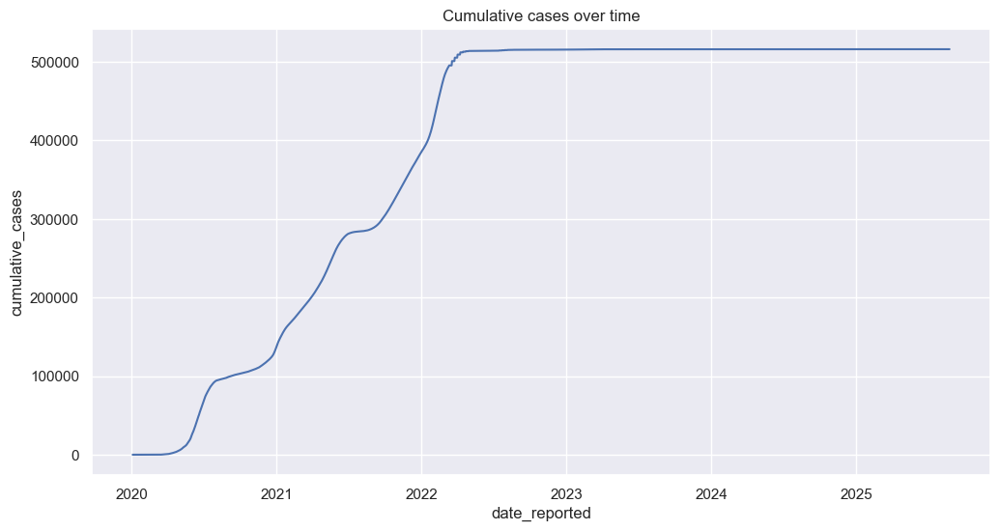

In [26]:
plt.figure(figsize=(12,6))
sns.lineplot(data=df_egypt , x='date_reported' , y='cumulative_cases'  )
plt.title ("Cumulative cases over time")
plt.show()

In [27]:
px.line(data_frame=df_egypt , x= 'date_reported' , y='cumulative_cases' , title="Cumulative cases over time with plotly express ")

In [28]:
def comulative_cases (country):
  fig =px.line(data_frame=df[df.country==country], x= 'date_reported' , y='cumulative_cases' , title=f"Cumulative cases over time for '{country}' ")
  fig.show()

In [29]:
comulative_cases("Egypt")

In [30]:
comulative_cases('United States of America')

In [31]:
def cumulative_deaths(country):
  fig =px.line(data_frame=df[df.country== country], x= 'date_reported' , y='cumulative_deaths' , title=f"Cumulative cases over time for '{country}' ")
  fig.show()

In [32]:
cumulative_deaths('Egypt')

In [33]:
def cumulative_cases_period(country,start,end,cumulative=f"cumulative_cases"):
  data =df[(df.country==country)&(df.date_reported>=start)&(df.date_reported<=end)]
  fig = px.line(data_frame=data , x= 'date_reported' , y=cumulative , title=f"{cumulative} over time for '{country}' ",markers=True)
  fig.show()
  
  

In [34]:
cumulative_cases_period('Egypt','2022-02-02','2022-03-02')

## Filter by Year

In [35]:
df['year'] = df.date_reported.dt.year
df['month'] = df.date_reported.dt.month

In [36]:
df.sample(3)

,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month
143431,2021-08-23,Vanuatu,WPR,0,3,0,0,2021,8
477660,2025-06-16,Peru,AMR,NaN,4532657,NaN,221059,2025,6
475414,2025-06-06,Sudan,EMR,NaN,63993,NaN,5046,2025,6


<Axes: xlabel='month', ylabel='new_cases'>

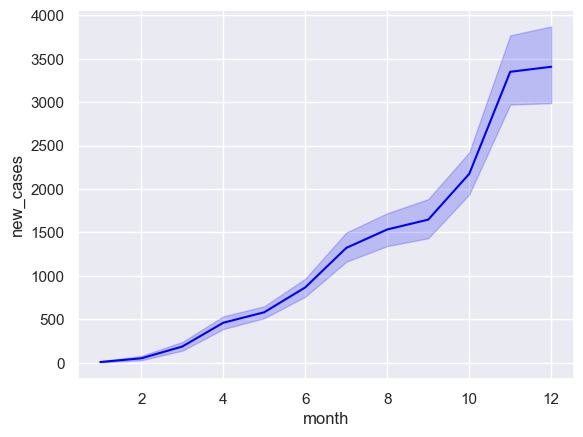

In [37]:
sns.lineplot(data=df[df.year==2020],x='month' ,y='new_cases' , color='Blue')

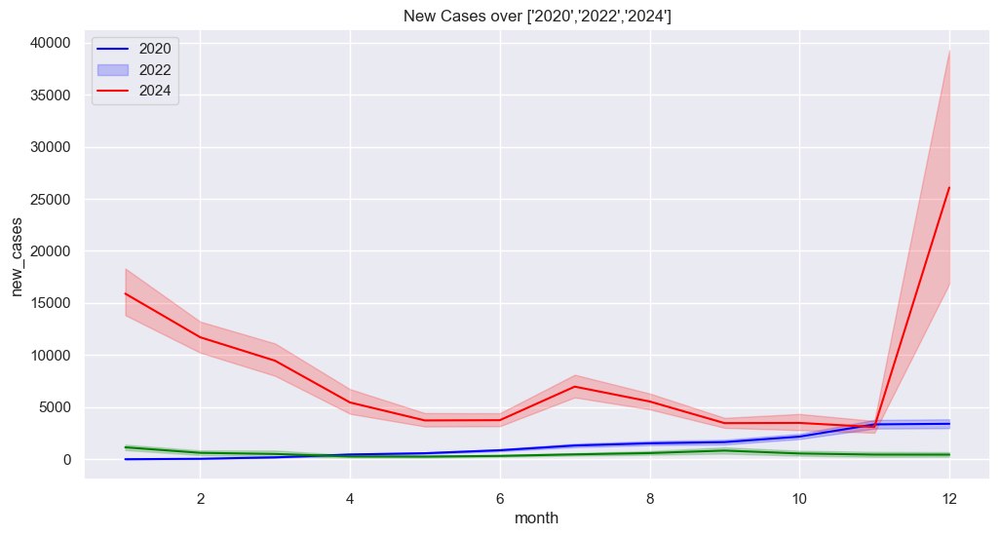

In [38]:
plt.figure(figsize=(12,6))
sns.lineplot(data=df[df.year==2020],x='month' ,y='new_cases' , color='Blue')
sns.lineplot(data=df[df.year==2022],x='month' ,y='new_cases' , color='Red')
sns.lineplot(data=df[df.year==2024],x='month' ,y='new_cases' , color='Green')
plt.legend(['2020','2022','2024'])
plt.title("New Cases over ['2020','2022','2024']")
plt.show()

<Axes: xlabel='month', ylabel='new_cases'>

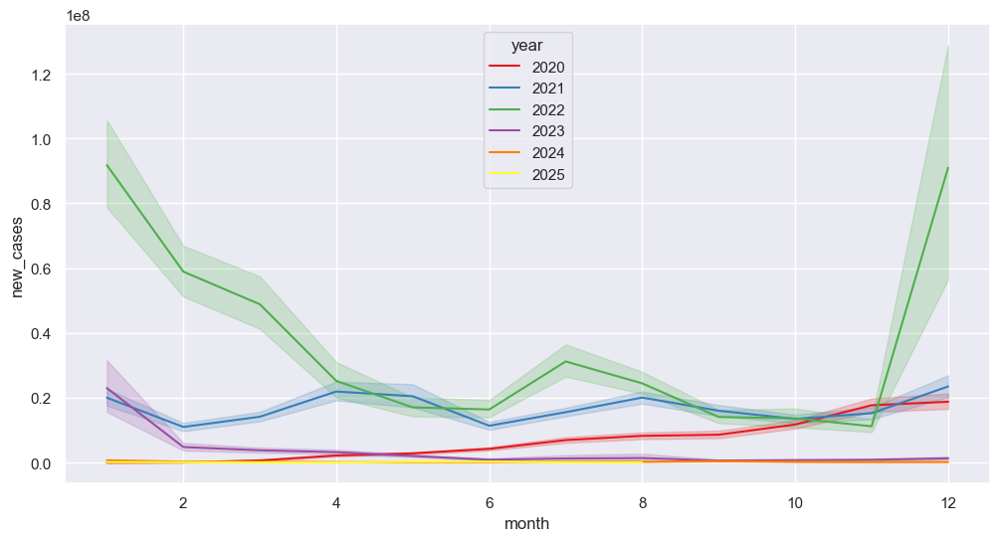

In [39]:
plt.figure(figsize=(12,6))
sns.lineplot(data=df,x='month' ,y='new_cases' ,hue='year' , palette='Set1',estimator=np.sum)

## Total Cases

In [40]:
def total_cases(year,cases='new_cases'):
  total = df[df.year==year].groupby('month')[cases].mean()
  print (total)

In [41]:
total_cases(2022)

month
1    15,897
2    11,711
3     9,459
4     5,452
5     3,728
6     3,751
7     6,972
8     5,548
9     3,470
10    3,489
11    3,096
12   26,077
Name: new_cases, dtype: float64


In [42]:
df.groupby('year')['new_cases'].sum().astype(float)

year
2020    82,335,574
2021   203,111,242
2022   444,029,532
2023    44,321,756
2024     3,553,879
2025     1,185,990
Name: new_cases, dtype: float64

In [43]:
df['month_year'] = df.date_reported.dt.to_period('M').astype(str)
df.sample()

,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year
417556,2024-10-08,Cambodia,WPR,NaN,139324,NaN,3056,2024,10,2024-10


In [44]:
px.bar(data_frame=df[df.year==2022] , x='month_year' , y='new_cases' )

In [46]:
px.histogram(df,x='month_year' , y='new_cases' , color='year' ,title='New Cases Over Time')

In [47]:
def total_cases(country, start_date = df.date_reported.min(), end_date = df.date_reported.max()):
    data = df[df.country == country]
    fig = px.histogram(data, x='month_year', y='new_cases', color='year', title=f'Total Cases for {country}',
         width=800, height=400, range_x=[start_date, end_date], nbins=50)
    fig.show()

In [48]:
total_cases('Egypt')

In [49]:
total_cases('Egypt', '2020-03', '2021-03')

In [50]:
total_cases('Egypt', '2020-03-15', '2021-05-15')

## Filter by region

In [51]:
df.who_region.unique()

array(['AMR', 'EUR', 'SEAR', 'AFR', 'WPR', 'EMR', 'OTHER'], dtype=object)

In [52]:
df[df.who_region == 'EMR'].country.unique()

array(['Iran (Islamic Republic of)', 'Jordan', 'Qatar',
       'Syrian Arab Republic', 'United Arab Emirates', 'Egypt', 'Libya',
       'Afghanistan', 'Somalia', 'Bahrain', 'Iraq', 'Lebanon', 'Oman',
       'Saudi Arabia', 'Djibouti', 'Kuwait', 'Morocco',
       'occupied Palestinian territory, including east Jerusalem',
       'Pakistan', 'Sudan', 'Tunisia', 'Yemen'], dtype=object)

In [57]:
def total_cases_region(region, start_date = df.date_reported.min(), end_date = df.date_reported.max()):
    data = df[df.who_region == region]
    fig = px.histogram(data, x='month_year', y='new_cases', color='year', title=f'Total Cases for {region}',
         width=800, height=400, range_x=[start_date, end_date], nbins=50)
    fig.show()

In [58]:
total_cases_region('EMR')

In [60]:
px.bar(df.groupby('who_region')['new_cases'].sum().sort_values(ascending=False) , title="Total cases by WHO Region")

## Top Countries

In [62]:
data = df.groupby('country')['new_cases'].sum().sort_values(ascending=False)
px.bar(data,title="Total Cases By Country", )

In [63]:
data = df.groupby('country')['cumulative_cases'].max().sort_values(ascending=False)
px.bar(data,title='Cumulative Cases by Country')

In [65]:
data = df[df['who_region']=='EMR'].groupby('country')['new_cases'].sum().sort_values(ascending=False)
px.bar(data,title='Total new cases By country in  EMR Region')

In [71]:
data = df[df['who_region']=='EMR'].groupby('country')['cumulative_deaths'].sum().sort_values(ascending=False)
px.bar(data,title='Total new cases By country in  EMR Region')

In [75]:
max_new_cases = df.query('new_cases==new_cases.max()')
print(max_new_cases['country'])
print (max_new_cases['date_reported'])
max_new_cases

260350    China
Name: country, dtype: object
260350   2022-12-23
Name: date_reported, dtype: datetime64[ns]


,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year
260350,2022-12-23,China,WPR,"6,966,046",50447985,894,36318,2022,12,2022-12


In [76]:
df.groupby('country')['new_cases'].max().nlargest(10)

country
China                          6,966,046
France                         2,417,043
Germany                        1,588,891
United States of America       1,265,520
Spain                            956,506
Netherlands (Kingdom of the)     626,302
Republic of Korea                621,328
Australia                        588,813
Viet Nam                         454,212
India                            414,188
Name: new_cases, dtype: float64

In [79]:
fig=px.bar(df.groupby('country')['new_cases'].max().nlargest(10),title="Top 10 countries wiht the most new Cases")
fig.update(layout_showlegend=False)
fig.update_layout(xaxis_title='Country' , yaxis_title ="New Cases")
fig.show()

In [84]:
fig = px.bar(df.groupby('country')['cumulative_deaths'].max().nlargest(10).sort_values(ascending=True),orientation='h', title="Top 10 Countries with the most Cumulative Death")
fig.update(layout_showlegend=False)
fig.update_layout(xaxis_title='country' , yaxis_title='Cumulative Deaths' )
fig.show()

In [85]:
def top10_countries(data, column):
    data = data.groupby('country')[column].max().nlargest(10)
    fig = px.bar(data, title=f'Top 10 Countries with the Most {column}', width=800, height=600)
    fig.update(layout_showlegend=False)
    fig.update_layout(xaxis_title='Country', yaxis_title=column)
    fig.show()

In [86]:
top10_countries(df, 'new_cases')

In [87]:
top10_countries(df, 'new_deaths')

In [88]:
top10_countries(df, 'cumulative_cases')

In [89]:
# 4 subplots in one figure plotly
from plotly.subplots import make_subplots
import plotly.graph_objects as go

In [90]:
data = df.groupby('country').max()
data

,date_reported,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year
country,,,,,,,,,
Afghanistan,2025-08-24,EMR,"3,243",235214,159,7998,2025,12,2025-08
Albania,2025-08-24,EUR,"2,832",337202,21,3608,2025,12,2025-08
Algeria,2025-08-24,AFR,"2,521",272394,49,6881,2025,12,2025-08
American Samoa,2025-08-24,WPR,955,8359,5,34,2025,12,2025-08
Andorra,2025-08-24,EUR,"1,676",48015,6,159,2025,12,2025-08
...,...,...,...,...,...,...,...,...,...
Wallis and Futuna,2025-08-24,WPR,"2,654",3760,7,9,2025,12,2025-08
Yemen,2025-08-24,EMR,287,11945,60,2159,2025,12,2025-08
Zambia,2025-08-24,AFR,"5,555",349892,72,4078,2025,12,2025-08


In [91]:
fig = make_subplots(rows=2, cols=2, subplot_titles=('New Cases', 'New Deaths', 'Cumulative Cases', 'Cumulative Deaths'))

fig.add_trace(go.Bar(x=data['new_cases'].nlargest(10).index, y=data['new_cases'].nlargest(10).values), row=1, col=1)
fig.add_trace(go.Bar(x=data['new_deaths'].nlargest(10).index, y=data['new_deaths'].nlargest(10).values), row=1, col=2)
fig.add_trace(go.Bar(x=data['cumulative_cases'].nlargest(10).index, y=data['cumulative_cases'].nlargest(10).values), row=2, col=1)
fig.add_trace(go.Bar(x=data['cumulative_deaths'].nlargest(10).index, y=data['cumulative_deaths'].nlargest(10).values), row=2, col=2)


fig.update(layout_showlegend=False)
fig.update_layout(height=900, width=1200, title_text='Top 10 Countries with the Most Cases and Deaths')
fig.show()

##  Create Easy Maps

In [95]:
df_all_max = df.groupby('country').max()
df_2022_max = df[df.year == 2022].groupby('country').max()
df_2024_max = df[df.year== 2024].groupby('country').max()

In [112]:
choromap=px.choropleth(df_all_max, locations=df_all_max.index, locationmode='country names', color=df_all_max['cumulative_cases'],
            width= 1000, height= 600, title='World wide Cumulative Cases covid19 cases', color_continuous_scale='Blues')  # Try Greens, Purples, Blues

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\2125234960.py:1: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.



In [105]:
data = dict(type = 'choropleth',                    #  ‘choropleth’ specifies that we are plotting a choropleth map
           locations = df_2022_max.index,           # list of country names
            locationmode = 'country names',         # the plotting level is country wise. The value can be “ISO-3” , “USA-states” , “country names”
            z = df_2022_max['cumulative_cases'],    # The value or factor that is used to distinguish the countries. These values are used by the colour scale.
            text = df_2022_max.index,               # The textual information to be displayed for each country on hover.
            colorscale= 'Hot',
            reversescale = False,
            marker = dict(line = dict(color='white',width=1)),
            colorbar = {'title':'cumulative_cases'})

Available color scales are:

> ‘Greys’, ‘YlGnBu’, ‘Greens’, ‘YlOrRd’, ‘Bluered’, ‘RdBu’, ‘Reds’, ‘Blues’, ‘Picnic’, ‘Rainbow’, ‘Portland’, ‘Jet’, ‘Hot’, ‘Blackbody’, ‘Earth’, ‘Electric’, ‘Viridis’, ‘Cividis’

In [106]:
layout = dict(title = 'World wide Cumulative Cases in 2021',
             geo = dict(showframe = False, projection = {'type':'mollweide'}))   # equirectangular

* Available projections :
> ‘equirectangular’, ‘mercator’, ‘orthographic’, ‘natural earth’, ‘kavrayskiy7’, ‘miller’, ‘robinson’, ‘eckert4’, ‘azimuthal equal area’, ‘azimuthal equidistant’, ‘conic equal area’, ‘conic conformal’, ‘conic equidistant’, ‘gnomonic’, ‘stereographic’, ‘mollweide’, ‘hammer’, ‘transverse mercator’, ‘albers usa’, ‘winkel tripel’, ‘aitoff’, ‘sinusoidal’.

In [107]:
go.Figure(data=[data],layout=layout)

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\1451595237.py:1: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.



In [108]:
def plot_map(data, column):
    data = dict(type = 'choropleth',
           locations = data.index,
            locationmode = 'country names',
            z = data[column],
            text = data.index,
            colorscale= 'agsunset',
            reversescale = False,
            marker = dict(line = dict(color='white',width=1)),
            colorbar = {'title': column } )

    layout = dict(title = f'World wide {column} covid19 cases',
             geo = dict(showframe = False, projection = {'type':'natural earth'}))

    choromap = go.Figure(data=[data],layout=layout)
    choromap.update_layout(margin={"r":0,"t":0,"l":0,"b":0}, width=1000, height=600)
    return(choromap)

In [110]:
plot_map(df_2024_max, 'cumulative_cases')

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\152603440.py:15: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.



In [111]:
plot_map(df_all_max, 'cumulative_deaths')

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\152603440.py:15: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.



In [113]:
# save the plot as html file
choromap.write_html('choromap.html')

In [114]:
from dash import Dash, html, dcc

fig = px.choropleth(df_2022_max, locations=df_2022_max.index, locationmode='country names', color=df_2022_max['new_cases'],
            width= 1000, height= 600, title='World wide Cumulative Cases covid19 cases', color_continuous_scale='Reds')  # Try Greens, Purples, Blues
fig2 = plot_map(df_all_max, 'cumulative_cases')

app = Dash()
app.layout = html.Div([ html.H1('World wide Cumulative Cases covid19 cases in 2022'),
                        dcc.Graph(figure=fig, id='my-graph'),
                        html.H2('World wide Cumulative Cases covid19 cases in 3 years'),
                        dcc.Graph(figure=fig2, id='my-graph2')])

app.run(mode='inline')

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\109033182.py:3: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.

C:\Users\Compu Rotana\AppData\Local\Temp\ipykernel_19796\152603440.py:15: DeprecationWarning:

The library used by the *country names* `locationmode` option is changing in an upcoming version. Country names in existing plots may not work in the new version. To ensure consistent behavior, consider setting `locationmode` to *ISO-3*.



 ## new column called 'season'

In [ ]:

def get_season(month):
    if month in [12, 1, 2]:
        return 'Winter'
    elif month in [3, 4, 5]:
        return 'Spring'
    elif month in [6, 7, 8]:
        return 'Summer'
    else:
        return 'Autumn'

df['season'] = df['month'].apply(get_season)


In [129]:
df.sample(3)

,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year,season
175342,2022-01-03,Netherlands (Kingdom of the),EUR,NaN,3195025,NaN,21092,2022,1,2022-01,Winter
192704,2022-03-16,Bolivia (Plurinational State of),AMR,434,898404,1,21476,2022,3,2022-03,Spring
323412,2023-09-12,Guernsey,EUR,NaN,35326,NaN,67,2023,9,2023-09,Autumn


## Filter by 'season'

In [135]:
# Filter by 'season': Find Total new cases per season and Visualize it.
data = df.groupby('season')['new_cases'].sum()
print (pd.DataFrame(data))
px.bar(data,x=data.index,y='new_cases' , title="Total new Cases Per Season")


         new_cases
season            
Autumn 125,197,320
Spring 163,772,069
Summer 143,583,522
Winter 345,985,062


In [136]:
# Filter by 'season': Find Total Deaths per season and Visualize it.
data = df.groupby('season')['cumulative_deaths'].sum()
print (pd.DataFrame(data))
px.bar(data,x=data.index,y='cumulative_deaths' , title="Total Cumulative Deaths Per Season")

        cumulative_deaths
season                   
Autumn         2436133873
Spring         2815089548
Summer         2922665473
Winter         2582335431


## Filter by 'region' and 'season'

In [139]:
df.sample()

,date_reported,country,who_region,new_cases,cumulative_cases,new_deaths,cumulative_deaths,year,month,month_year,season
186163,2022-02-17,Marshall Islands,WPR,0,7,0,0,2022,2,2022-02,Winter


In [148]:
data = df.groupby(['who_region', 'season'])['new_cases'].sum().reset_index()


fig = px.bar(
    data, 
    x='who_region', 
    y='new_cases', 
    color='season', 
    title='Total New Cases per Season by Region'
)
fig.show()

In [149]:
for region in df['who_region'].unique():
    data = df[df['who_region'] == region].groupby('season')[['new_cases', 'new_deaths']].sum()
    fig = px.bar(data, x=data.index, y='new_cases', title=' Total new cases per season in ' + region)
    fig.show()

In [1]:
import streamlit as st
import pandas as pd
import numpy as np
import plotly
import matplotlib
import seaborn as sns

print("📌 Versions of libraries used:")
print("Streamlit :", st.__version__)
print("Pandas    :", pd.__version__)
print("NumPy     :", np.__version__)
print("Plotly    :", plotly.__version__)
print("Matplotlib:", matplotlib.__version__)
print("Seaborn   :", sns.__version__)

📌 Versions of libraries used:
Streamlit : 1.45.1
Pandas    : 2.2.3
NumPy     : 1.26.4
Plotly    : 6.3.0
Matplotlib: 3.9.2
Seaborn   : 0.13.2
